<a href="https://colab.research.google.com/github/juliabs24/dengue_julia/blob/main/casos_dive_pivot_total.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Montando Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
!ls

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
drive  sample_data


# Importando Bibliotecas

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
!pip install cartopy
import cartopy.crs as ccrs

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.7/11.7 MB 45.1 MB/s eta 0:00:00


# Abrindo Arquivos

In [ ]:
url = "https://raw.githubusercontent.com/matheusf30/dados_dengue/refs/heads/main/casos_dive_pivot_total.csv" #raw
casos = pd.read_csv(url)
print(casos.head())
casos.head() # Diferença na apresentação gráfica
# Everton - TMIN
# Bia - TMED
# Júlia - TMAX
# Domênica - PREC (GFS)
# Murilo - PREC (MERGE) / CASOS
# Carol - FOCOS



       Semana  ABDON BATISTA  ABELARDO LUZ  ALFREDO WAGNER  ALTO BELA VISTA  \
0  2014-01-05              0             0               0                0   
1  2014-01-12              0             0               0                0   
2  2014-01-19              0             0               0                0   
3  2014-01-26              0             0               0                0   
4  2014-02-02              0             0               0                0   

   ANCHIETA  ANITÁPOLIS  ANTÔNIO CARLOS  APIÚNA  ARABUTÃ  ...  VIDAL RAMOS  \
0         0         0.0               0     0.0        0  ...            0   
1         0         0.0               0     0.0        0  ...            0   
2         0         0.0               0     0.0        0  ...            0   
3         0         0.0               0     0.0        0  ...            0   
4         0         0.0               0     0.0        0  ...            0   

   VIDEIRA  XANXERÊ  XAVANTINA  XAXIM  ZORTÉA  ÁGUA DOCE

,Semana,ABDON BATISTA,ABELARDO LUZ,ALFREDO WAGNER,ALTO BELA VISTA,ANCHIETA,ANITÁPOLIS,ANTÔNIO CARLOS,APIÚNA,ARABUTÃ,...,VIDAL RAMOS,VIDEIRA,XANXERÊ,XAVANTINA,XAXIM,ZORTÉA,ÁGUA DOCE,ÁGUAS DE CHAPECÓ,ÁGUAS FRIAS,ÁGUAS MORNAS
0,2014-01-05,0,0,0,0,0,0.0,0,0.0,0,...,0,0,0,0,0,0,0,0,0,0
1,2014-01-12,0,0,0,0,0,0.0,0,0.0,0,...,0,0,0,0,0,0,0,0,0,0
2,2014-01-19,0,0,0,0,0,0.0,0,0.0,0,...,0,0,0,0,0,0,0,0,0,0
3,2014-01-26,0,0,0,0,0,0.0,0,0.0,0,...,0,0,0,0,0,0,0,0,0,0
4,2014-02-02,0,0,0,0,0,0.0,0,0.0,0,...,0,0,0,0,0,0,0,0,0,0


# Analisando Variáveis

In [ ]:
print(casos.info())
print("="*50)
print(casos.dtypes)
print("="*50)
print(casos.describe())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 573 entries, 0 to 572
Columns: 232 entries, Semana to ÁGUAS MORNAS
dtypes: float64(21), int64(210), object(1)
memory usage: 1.0+ MB
None
Semana              object
ABDON BATISTA        int64
ABELARDO LUZ         int64
ALFREDO WAGNER       int64
ALTO BELA VISTA      int64
                     ...  
ZORTÉA               int64
ÁGUA DOCE            int64
ÁGUAS DE CHAPECÓ     int64
ÁGUAS FRIAS          int64
ÁGUAS MORNAS         int64
Length: 232, dtype: object
       ABDON BATISTA  ABELARDO LUZ  ALFREDO WAGNER  ALTO BELA VISTA  \
count     573.000000    573.000000      573.000000       573.000000   
mean        0.001745      1.579407        0.005236         0.041885   
std         0.041776     12.360525        0.072231         0.543549   
min         0.000000      0.000000        0.000000         0.000000   
25%         0.000000      0.000000        0.000000         0.000000   
50%         0.000000      0.000000        0.000000         0.00

# Pré-processamento

In [ ]:
casos["Semana"] = pd.to_datetime(casos["Semana"])
print(casos.dtypes)

Semana              datetime64[ns]
ABDON BATISTA                int64
ABELARDO LUZ                 int64
ALFREDO WAGNER               int64
ALTO BELA VISTA              int64
                         ...      
ZORTÉA                       int64
ÁGUA DOCE                    int64
ÁGUAS DE CHAPECÓ             int64
ÁGUAS FRIAS                  int64
ÁGUAS MORNAS                 int64
Length: 232, dtype: object


In [ ]:
municipios = casos.columns[1:]
print(municipios)

Index(['ABDON BATISTA', 'ABELARDO LUZ', 'ALFREDO WAGNER', 'ALTO BELA VISTA',
       'ANCHIETA', 'ANITÁPOLIS', 'ANTÔNIO CARLOS', 'APIÚNA', 'ARABUTÃ',
       'ARAQUARI',
       ...
       'VIDAL RAMOS', 'VIDEIRA', 'XANXERÊ', 'XAVANTINA', 'XAXIM', 'ZORTÉA',
       'ÁGUA DOCE', 'ÁGUAS DE CHAPECÓ', 'ÁGUAS FRIAS', 'ÁGUAS MORNAS'],
      dtype='object', length=231)


In [ ]:
for municipio in municipios:
  max = casos[municipio].max()
  min = casos[municipio].min()
  soma = casos[municipio].sum()
  print("=" * 50)
  print(f"Analisando o município: {municipio}")
  print("~" * 50)
  print(f"O valor máximo é: {max}")
  print("~" * 50)
  print(f"O valor mínimo é: {min}")
  print("~" * 50)
  print(f"A soma da série histórica é: {soma}")

Analisando o município: ABDON BATISTA
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
O valor máximo é: 1
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
O valor mínimo é: 0
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
A soma da série histórica é: 1
Analisando o município: ABELARDO LUZ
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
O valor máximo é: 174
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
O valor mínimo é: 0
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
A soma da série histórica é: 905
Analisando o município: ALFREDO WAGNER
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
O valor máximo é: 1
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
O valor mínimo é: 0
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
A soma da série histórica é: 3
Analisando o município: ALTO BELA VISTA
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
O valor máximo é: 11
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
O valor mínimo é: 0
~~~~~~~~~~~~~~~~~~~~~~~~~~~

In [ ]:
max = {}
min = {}
soma = {}
for municipio in municipios:
  max[municipio] = casos[municipio].max()
  min[municipio] = casos[municipio].min()
  soma[municipio] = casos[municipio].sum()
print(max)
print(min)
print(soma)

{'ABDON BATISTA': 1, 'ABELARDO LUZ': 174, 'ALFREDO WAGNER': 1, 'ALTO BELA VISTA': 11, 'ANCHIETA': 17, 'ANITÁPOLIS': 2.0, 'ANTÔNIO CARLOS': 3, 'APIÚNA': 63.0, 'ARABUTÃ': 2, 'ARAQUARI': 445.0, 'ARARANGUÁ': 5, 'ARROIO TRINTA': 3, 'ARVOREDO': 4, 'ASCURRA': 49, 'AURORA': 1, 'BALNEÁRIO BARRA DO SUL': 18, 'BALNEÁRIO CAMBORIÚ': 691.0, 'BALNEÁRIO GAIVOTA': 3, 'BALNEÁRIO PIÇARRAS': 189.0, 'BALNEÁRIO RINCÃO': 1, 'BANDEIRANTE': 1, 'BARRA BONITA': 9, 'BARRA VELHA': 347, 'BELMONTE': 77, 'BENEDITO NOVO': 1, 'BIGUAÇU': 143, 'BLUMENAU': 3100.0, 'BOM JARDIM DA SERRA': 1, 'BOM JESUS': 65, 'BOM JESUS DO OESTE': 4, 'BOMBINHAS': 204, 'BOTUVERÁ': 1, 'BRAÇO DO NORTE': 88, 'BRUSQUE': 604.0, 'CAIBI': 89, 'CAMBORIÚ': 123.0, 'CAMPO ALEGRE': 1, 'CAMPO ERÊ': 92, 'CAMPOS NOVOS': 21, 'CANELINHA': 1, 'CANOINHAS': 2, 'CAPINZAL': 62, 'CAPIVARI DE BAIXO': 1, 'CAPÃO ALTO': 1, 'CATANDUVAS': 1, 'CAXAMBU DO SUL': 78, 'CAÇADOR': 7, 'CELSO RAMOS': 1, 'CHAPECÓ': 1164, 'COCAL DO SUL': 1, 'CONCÓRDIA': 584, 'CORDILHEIRA ALTA': 12,

In [ ]:
df_max = pd.DataFrame(list(max.items()), columns=['Município', 'Máximo'])
df_min = pd.DataFrame(list(min.items()), columns=['Município', 'Mínimo'])
df_soma = pd.DataFrame(list(soma.items()), columns=['Município', 'Soma'])
print(df_max)
print(df_min)
print(df_soma)

            Município  Máximo
0       ABDON BATISTA     1.0
1        ABELARDO LUZ   174.0
2      ALFREDO WAGNER     1.0
3     ALTO BELA VISTA    11.0
4            ANCHIETA    17.0
..                ...     ...
226            ZORTÉA     4.0
227         ÁGUA DOCE     1.0
228  ÁGUAS DE CHAPECÓ   145.0
229       ÁGUAS FRIAS    13.0
230      ÁGUAS MORNAS     1.0

[231 rows x 2 columns]
            Município  Mínimo
0       ABDON BATISTA     0.0
1        ABELARDO LUZ     0.0
2      ALFREDO WAGNER     0.0
3     ALTO BELA VISTA     0.0
4            ANCHIETA     0.0
..                ...     ...
226            ZORTÉA     0.0
227         ÁGUA DOCE     0.0
228  ÁGUAS DE CHAPECÓ     0.0
229       ÁGUAS FRIAS     0.0
230      ÁGUAS MORNAS     0.0

[231 rows x 2 columns]
            Município    Soma
0       ABDON BATISTA     1.0
1        ABELARDO LUZ   905.0
2      ALFREDO WAGNER     3.0
3     ALTO BELA VISTA    24.0
4            ANCHIETA   136.0
..                ...     ...
226            ZORTÉA 

In [ ]:
df_max = df_max.sort_values(by = "Máximo", ascending = False)
df_min = df_min.sort_values(by = "Mínimo", ascending = True)
df_soma = df_soma.sort_values(by = "Soma", ascending = False)
df_soma_asc = df_soma.sort_values(by = "Soma", ascending = True)
print(df_max)
print(df_min)
print(df_soma)
print(df_soma_asc)

          Município  Máximo
112       JOINVILLE  6638.0
26         BLUMENAU  3100.0
67    FLORIANÓPOLIS  2473.0
109  JARAGUÁ DO SUL  2021.0
100          ITAJAÍ  1533.0
..              ...     ...
218       URUSSANGA     1.0
217         URUBICI     1.0
220         VARGEÃO     1.0
227       ÁGUA DOCE     1.0
230    ÁGUAS MORNAS     1.0

[231 rows x 2 columns]
            Município  Mínimo
0       ABDON BATISTA     0.0
1        ABELARDO LUZ     0.0
2      ALFREDO WAGNER     0.0
3     ALTO BELA VISTA     0.0
4            ANCHIETA     0.0
..                ...     ...
226            ZORTÉA     0.0
227         ÁGUA DOCE     0.0
228  ÁGUAS DE CHAPECÓ     0.0
229       ÁGUAS FRIAS     0.0
230      ÁGUAS MORNAS     0.0

[231 rows x 2 columns]
           Município      Soma
112        JOINVILLE  173721.0
26          BLUMENAU   42644.5
67     FLORIANÓPOLIS   28632.5
100           ITAJAÍ   19845.5
109   JARAGUÁ DO SUL   17757.0
..               ...       ...
180  SANTA TEREZINHA       1.0
192    S

# Visualização Gráfica

## Barras

### Máximos

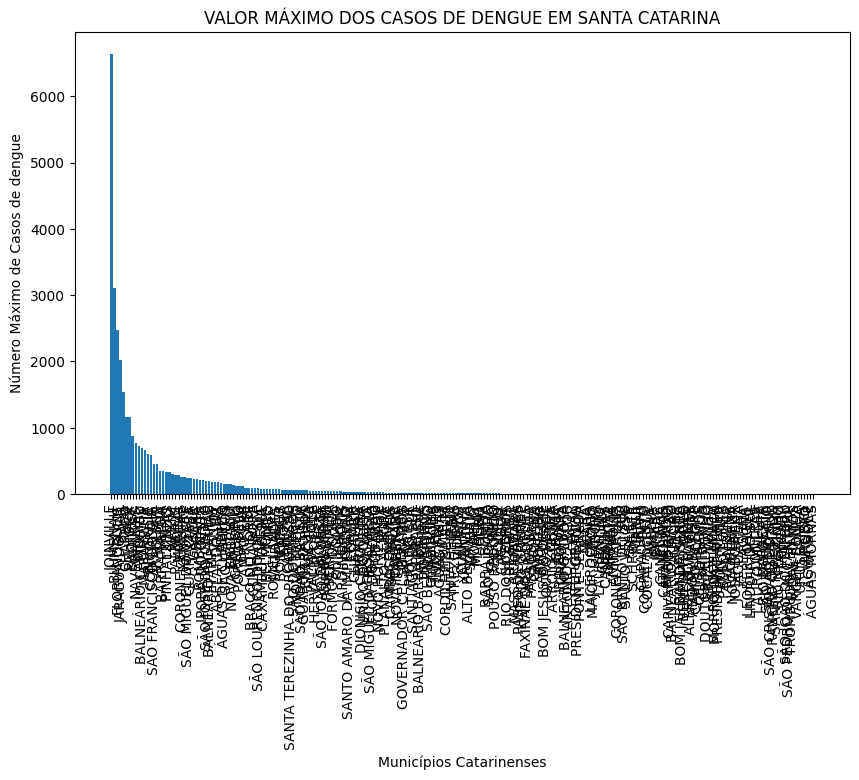

In [ ]:
plt.figure(figsize=(10, 6))
plt.bar(df_max["Município"], df_max["Máximo"])
plt.title("VALOR MÁXIMO DOS CASOS DE DENGUE EM SANTA CATARINA")
plt.xlabel("Municípios Catarinenses")
plt.xticks(rotation = 90)
plt.ylabel("Número Máximo de Casos de dengue")
plt.show()

                Município  Máximo
112             JOINVILLE  6638.0
26               BLUMENAU  3100.0
67          FLORIANÓPOLIS  2473.0
109        JARAGUÁ DO SUL  2021.0
100                ITAJAÍ  1533.0
48                CHAPECÓ  1164.0
145               PALHOÇA  1156.0
197              SÃO JOSÉ   877.0
135            NAVEGANTES   769.0
90                INDAIAL   731.0
16     BALNEÁRIO CAMBORIÚ   691.0
129             MARAVILHA   666.0
33                BRUSQUE   604.0
50              CONCÓRDIA   584.0
196  SÃO FRANCISCO DO SUL   452.0
9                ARAQUARI   445.0
103                ITAPOÁ   354.0
22            BARRA VELHA   347.0
155           PINHALZINHO   338.0
210               TIJUCAS   324.0


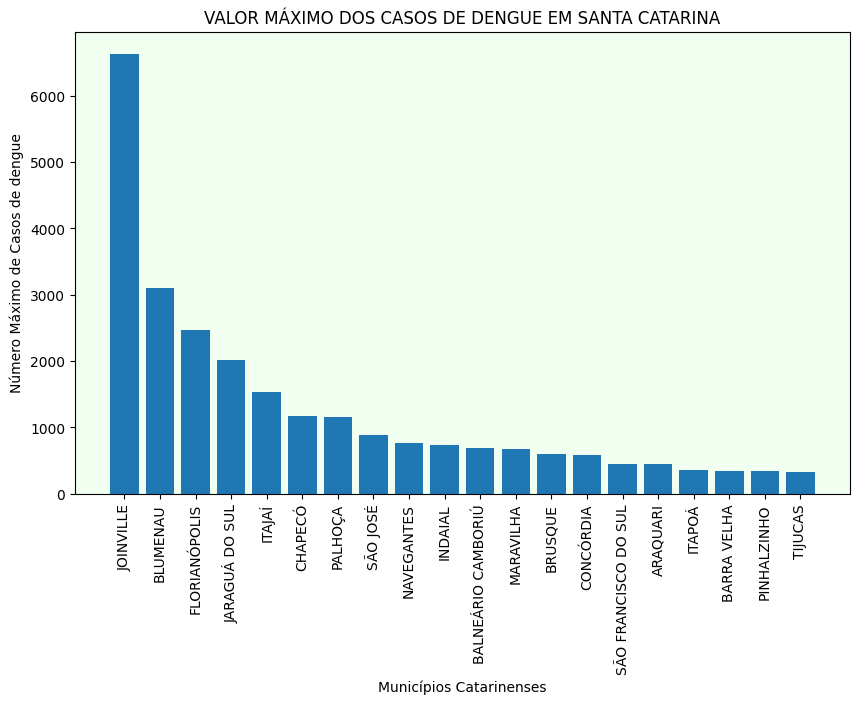

In [ ]:
principais_max = df_max.head(20)
print(principais_max)
plt.figure(figsize=(10, 6))
plt.bar(principais_max["Município"], principais_max["Máximo"])
plt.title("VALOR MÁXIMO DOS CASOS DE DENGUE EM SANTA CATARINA")
plt.xlabel("Municípios Catarinenses")
plt.xticks(rotation = 90)
plt.ylabel("Número Máximo de Casos de dengue")
plt.gca().patch.set_facecolor("honeydew")
plt.show()

### Mínimos

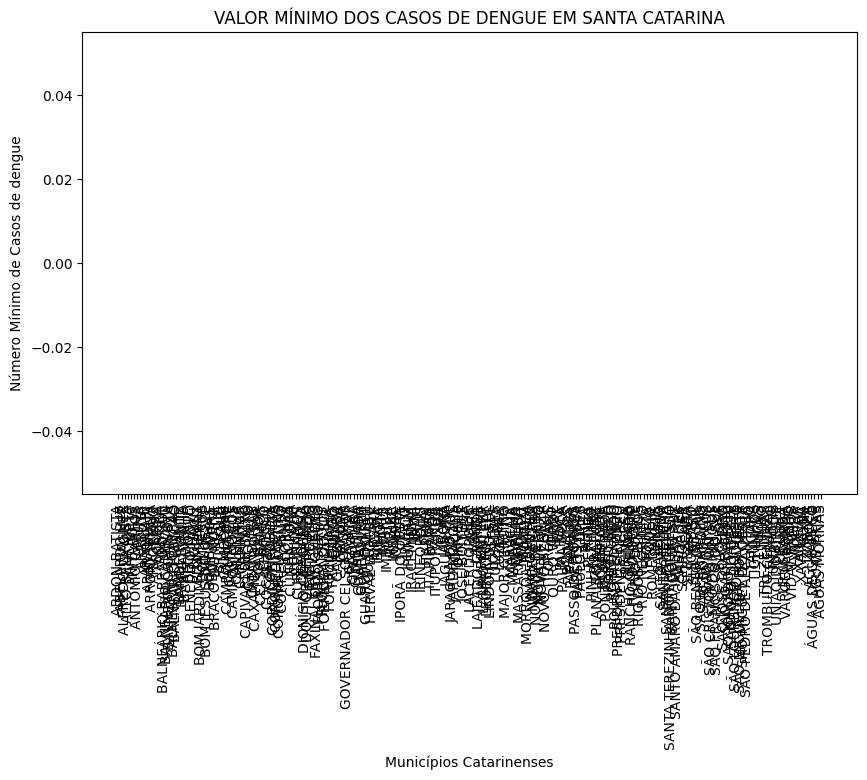

In [ ]:
plt.figure(figsize=(10, 6))
plt.bar(df_min["Município"], df_min["Mínimo"])
plt.title("VALOR MÍNIMO DOS CASOS DE DENGUE EM SANTA CATARINA")
plt.xlabel("Municípios Catarinenses")
plt.xticks(rotation = 90)
plt.ylabel("Número Mínimo de Casos de dengue")
plt.show()

                 Município  Mínimo
0            ABDON BATISTA     0.0
1             ABELARDO LUZ     0.0
2           ALFREDO WAGNER     0.0
3          ALTO BELA VISTA     0.0
4                 ANCHIETA     0.0
5               ANITÁPOLIS     0.0
6           ANTÔNIO CARLOS     0.0
7                   APIÚNA     0.0
8                  ARABUTÃ     0.0
9                 ARAQUARI     0.0
10               ARARANGUÁ     0.0
11           ARROIO TRINTA     0.0
12                ARVOREDO     0.0
13                 ASCURRA     0.0
14                  AURORA     0.0
15  BALNEÁRIO BARRA DO SUL     0.0
16      BALNEÁRIO CAMBORIÚ     0.0
17       BALNEÁRIO GAIVOTA     0.0
18      BALNEÁRIO PIÇARRAS     0.0
19        BALNEÁRIO RINCÃO     0.0


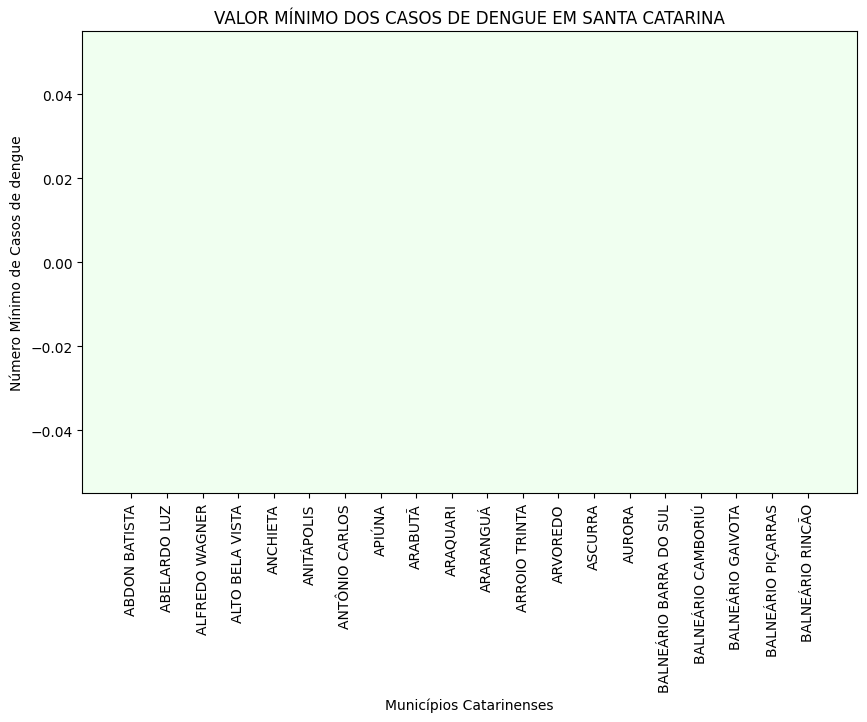

In [ ]:
principais_min = df_min.head(20)
print(principais_min)
plt.figure(figsize=(10, 6))
plt.bar(principais_min["Município"], principais_min["Mínimo"])
plt.title("VALOR MÍNIMO DOS CASOS DE DENGUE EM SANTA CATARINA")
plt.xlabel("Municípios Catarinenses")
plt.xticks(rotation = 90)
plt.ylabel("Número Mínimo de Casos de dengue")
plt.gca().patch.set_facecolor("honeydew")
plt.show()

### Acumulado

#### Ascendente

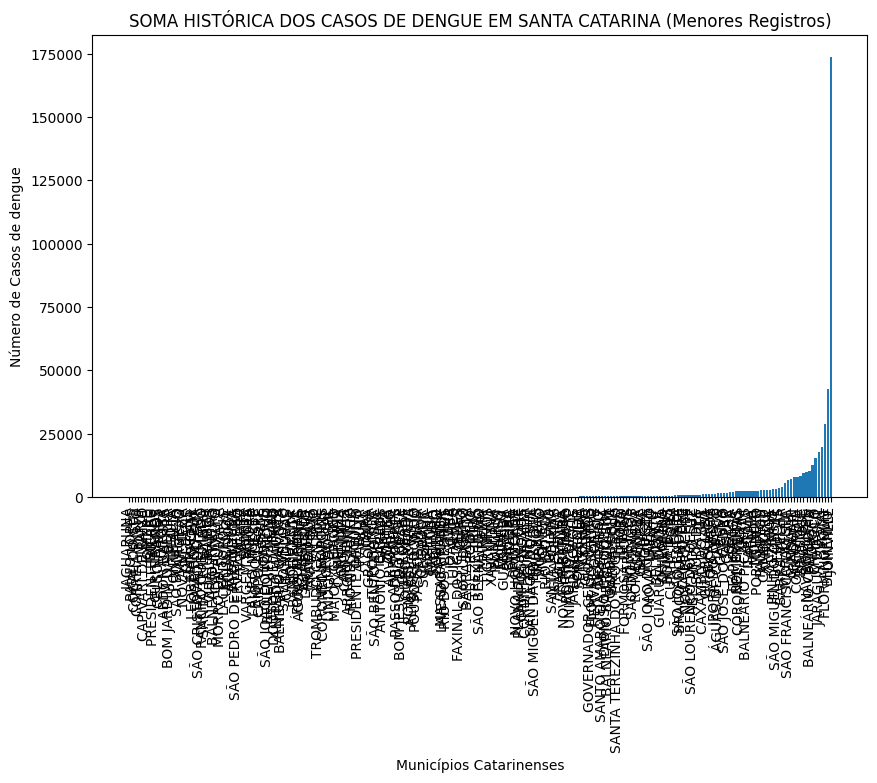

In [ ]:
plt.figure(figsize=(10, 6))
plt.bar(df_soma_asc["Município"], df_soma_asc["Soma"])
plt.title("SOMA HISTÓRICA DOS CASOS DE DENGUE EM SANTA CATARINA (Menores Registros)")
plt.xlabel("Municípios Catarinenses")
plt.xticks(rotation = 90)
plt.ylabel("Número de Casos de dengue")
plt.show()

                  Município  Soma
108               JAGUARUNA   1.0
152             PAULO LOPES   1.0
49             COCAL DO SUL   1.0
54            CORREIA PINTO   1.0
87                   IMARUÍ   1.0
42        CAPIVARI DE BAIXO   1.0
91                   IOMERÊ   1.0
84                  IBICARÉ   1.0
165        PRESIDENTE NEREU   1.0
59              CURITIBANOS   1.0
47              CELSO RAMOS   1.0
14                   AURORA   1.0
0             ABDON BATISTA   1.0
27      BOM JARDIM DA SERRA   1.0
89                   IMBUIA   1.0
159              PONTE ALTA   1.0
192           SÃO BONIFÁCIO   1.0
220                 VARGEÃO   1.0
139             NOVA VENEZA   1.0
141                 ORLEANS   1.0
128                MARACAJÁ   1.0
121           LEOBERTO LEAL   1.0
113            JOSÉ BOITEUX   1.0
194    SÃO CRISTOVÃO DO SUL   1.0
168         RANCHO QUEIMADO   1.0
180         SANTA TEREZINHA   1.0
217                 URUBICI   1.0
221             VIDAL RAMOS   1.0
19         BAL

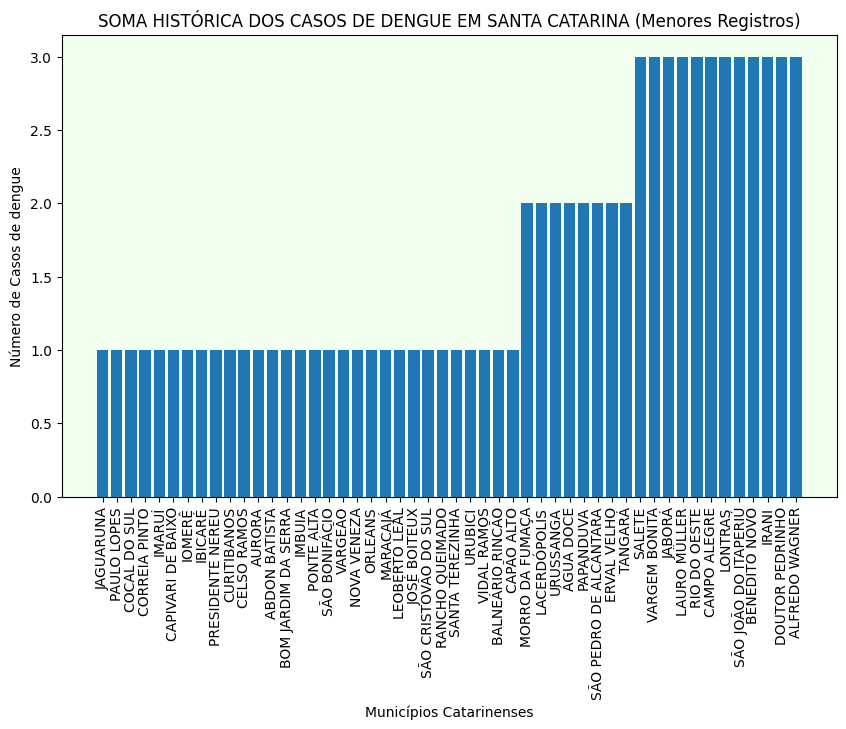

In [ ]:
principais_soma_asc = df_soma_asc.head(50)
print(principais_soma_asc)
plt.figure(figsize=(10, 6))
plt.bar(principais_soma_asc["Município"], principais_soma_asc["Soma"])
plt.title("SOMA HISTÓRICA DOS CASOS DE DENGUE EM SANTA CATARINA (Menores Registros)")
plt.xlabel("Municípios Catarinenses")
plt.xticks(rotation = 90)
plt.ylabel("Número de Casos de dengue")
plt.gca().patch.set_facecolor("honeydew")
plt.show()

#### Descendente

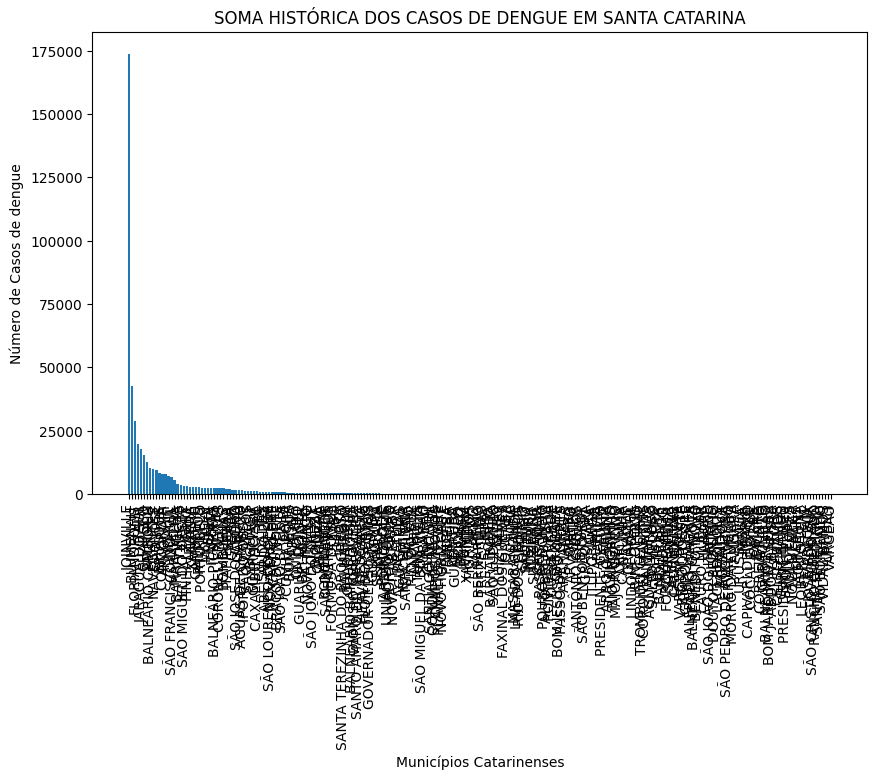

In [ ]:
plt.figure(figsize=(10, 6))
plt.bar(df_soma["Município"], df_soma["Soma"])
plt.title("SOMA HISTÓRICA DOS CASOS DE DENGUE EM SANTA CATARINA")
plt.xlabel("Municípios Catarinenses")
plt.xticks(rotation = 90)
plt.ylabel("Número de Casos de dengue")
plt.show()

                Município      Soma
112             JOINVILLE  173721.0
26               BLUMENAU   42644.5
67          FLORIANÓPOLIS   28632.5
100                ITAJAÍ   19845.5
109        JARAGUÁ DO SUL   17757.0
48                CHAPECÓ   15475.0
145               PALHOÇA   12541.5
16     BALNEÁRIO CAMBORIÚ   10093.5
135            NAVEGANTES    9763.5
197              SÃO JOSÉ    9606.0
33                BRUSQUE    8108.5
50              CONCÓRDIA    7834.0
9                ARAQUARI    7778.5
90                INDAIAL    6981.5
196  SÃO FRANCISCO DO SUL    6705.5
129             MARAVILHA    5401.5
22            BARRA VELHA    3997.0
210               TIJUCAS    3585.0
205   SÃO MIGUEL DO OESTE    3043.5
155           PINHALZINHO    3031.0


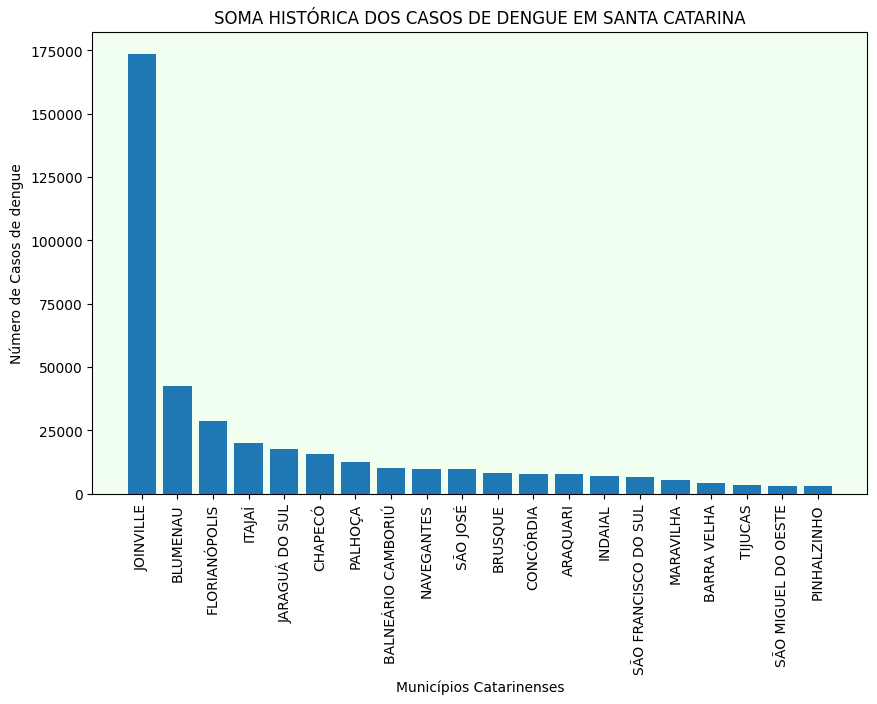

In [ ]:
principais_soma = df_soma.head(20)
print(principais_soma)
plt.figure(figsize=(10, 6))
plt.bar(principais_soma["Município"], principais_soma["Soma"])
plt.title("SOMA HISTÓRICA DOS CASOS DE DENGUE EM SANTA CATARINA")
plt.xlabel("Municípios Catarinenses")
plt.xticks(rotation = 90)
plt.ylabel("Número de Casos de dengue")
plt.gca().patch.set_facecolor("honeydew")
plt.show()

## Série Temporal

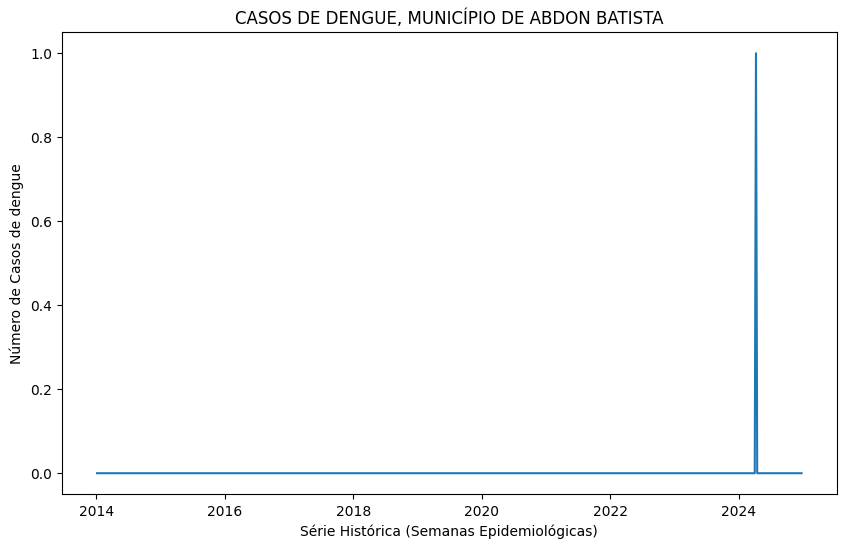

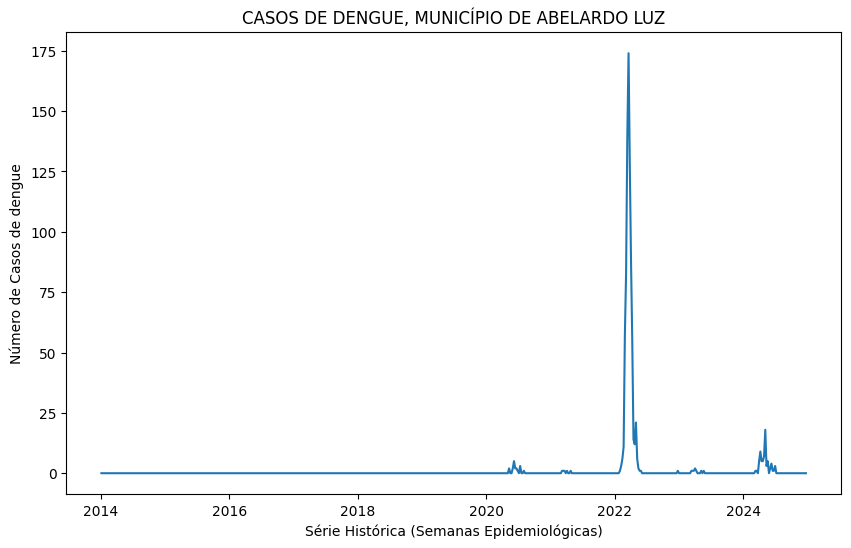

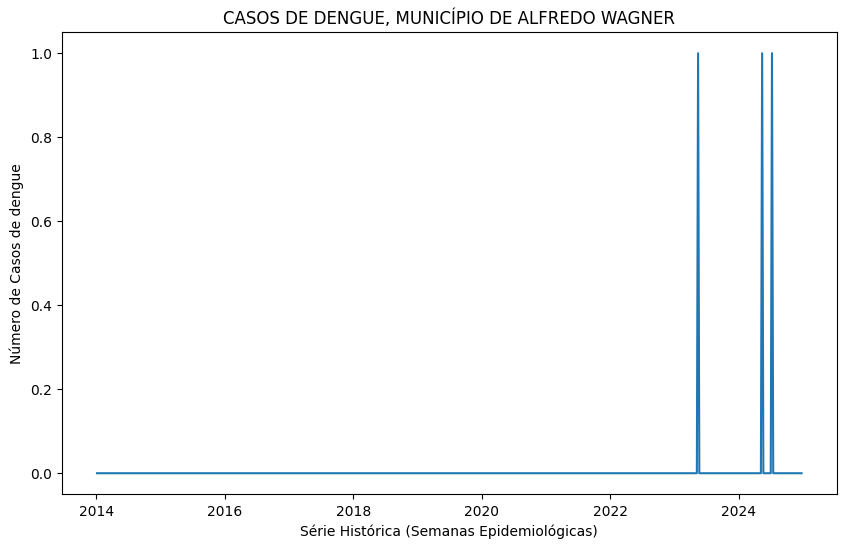

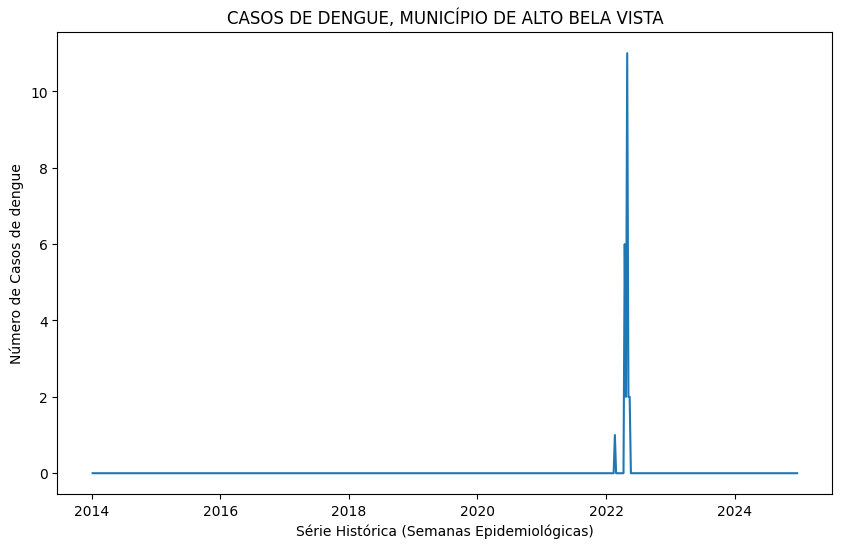

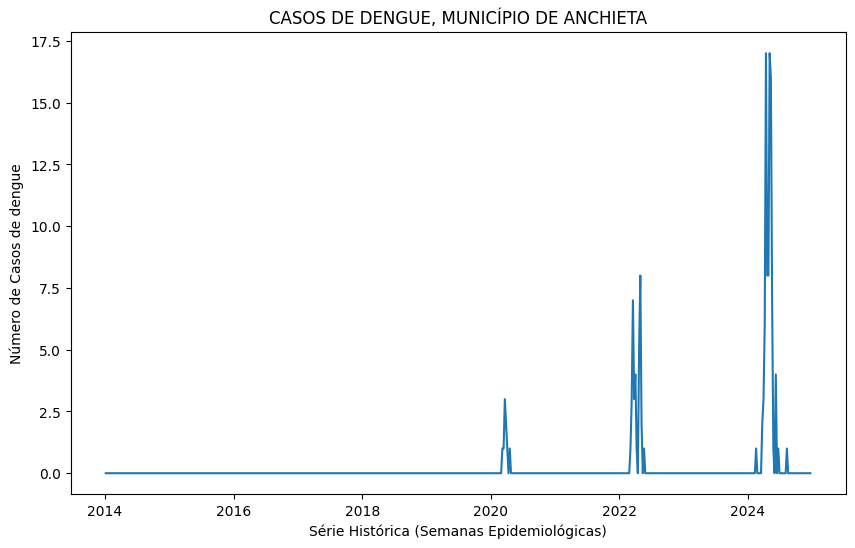

...

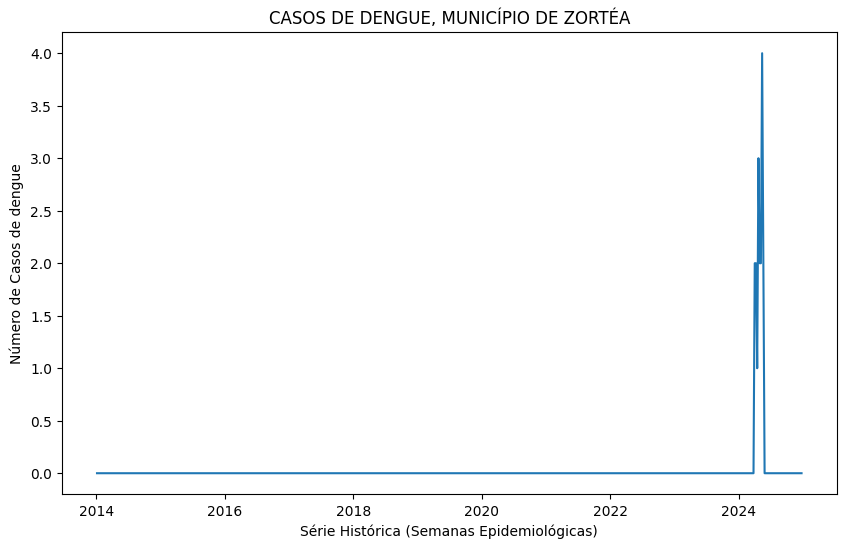

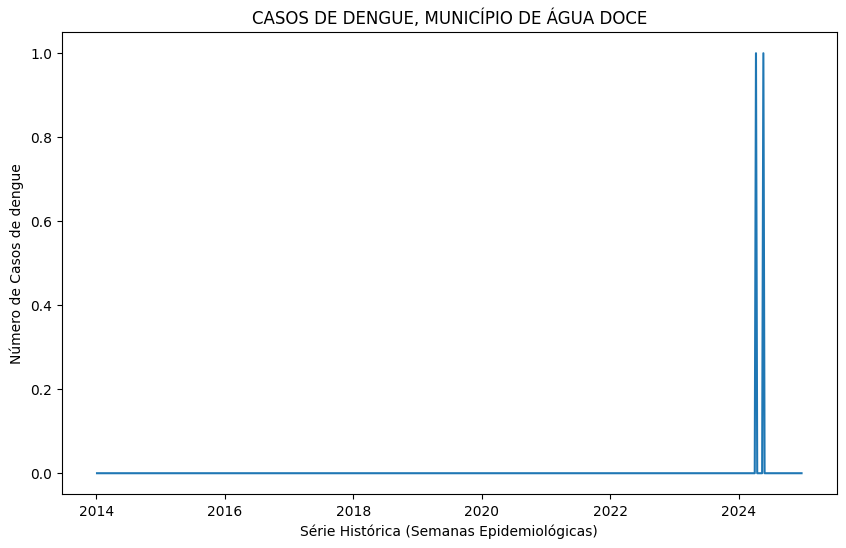

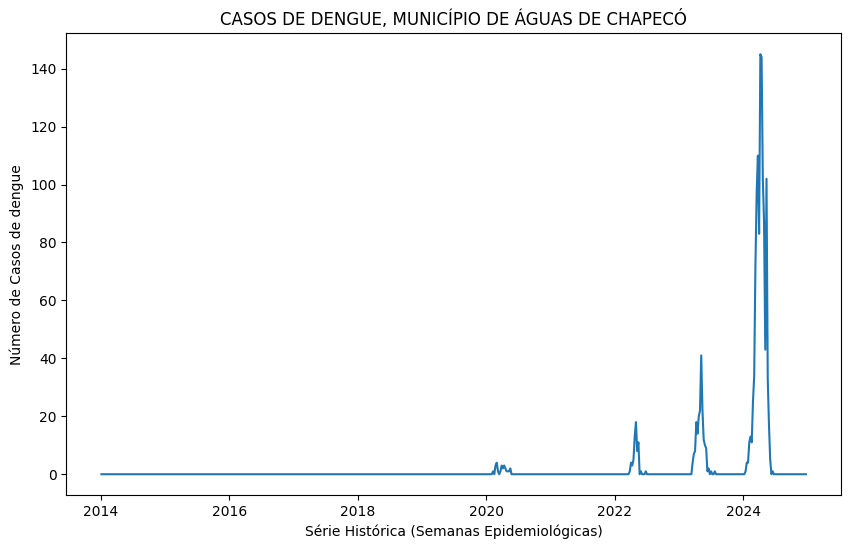

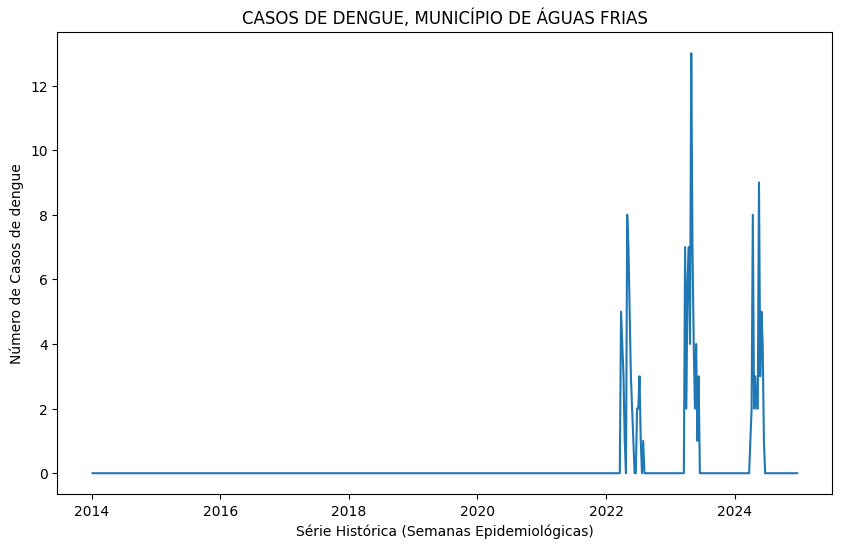

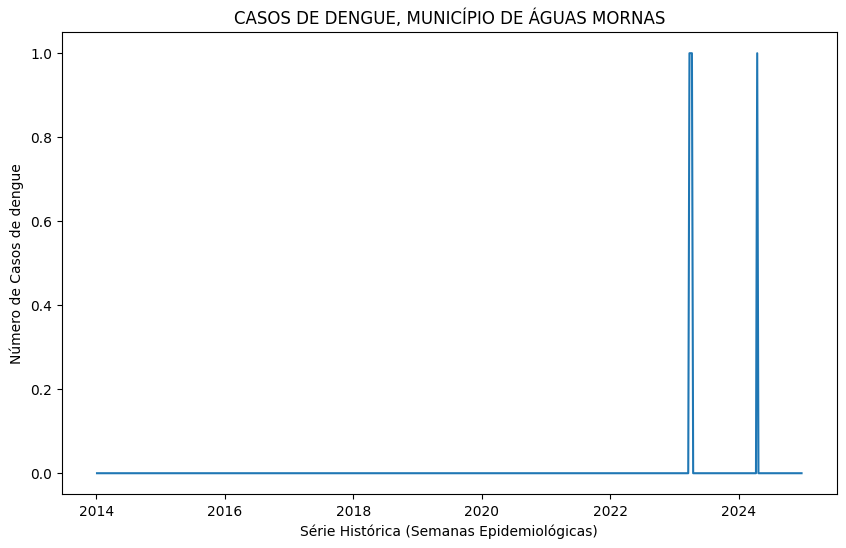

In [ ]:
for municipio in municipios:
  plt.figure(figsize=(10, 6))
  plt.plot(casos["Semana"], casos[municipio])
  plt.title(f"CASOS DE DENGUE, MUNICÍPIO DE {municipio}")
  plt.xlabel("Série Histórica (Semanas Epidemiológicas)")
  plt.ylabel("Número de Casos de dengue")
  plt.show()

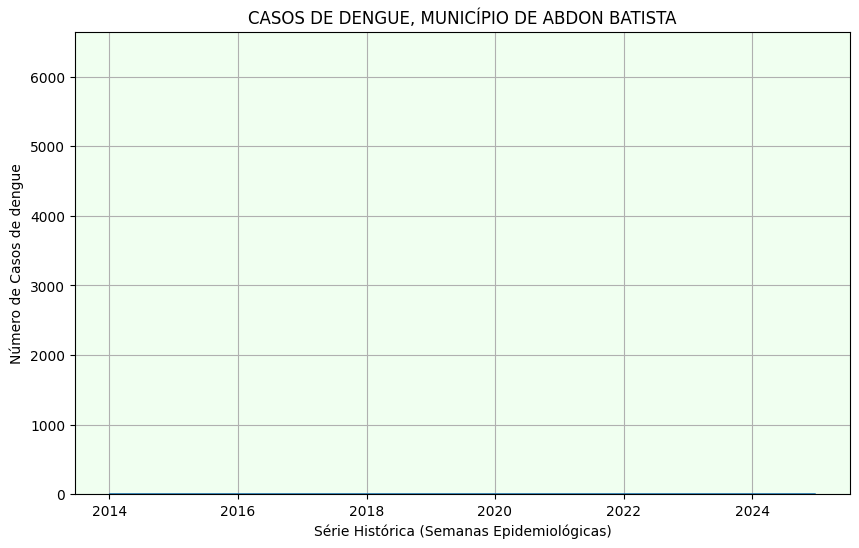

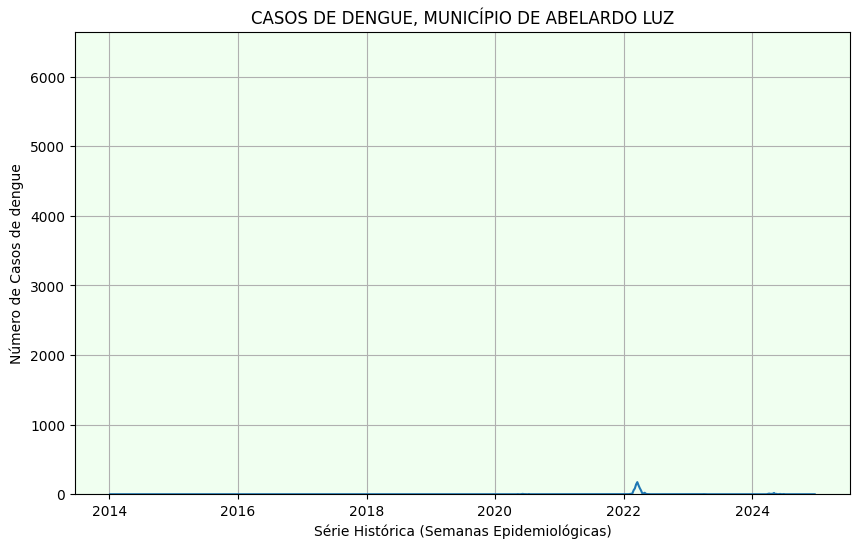

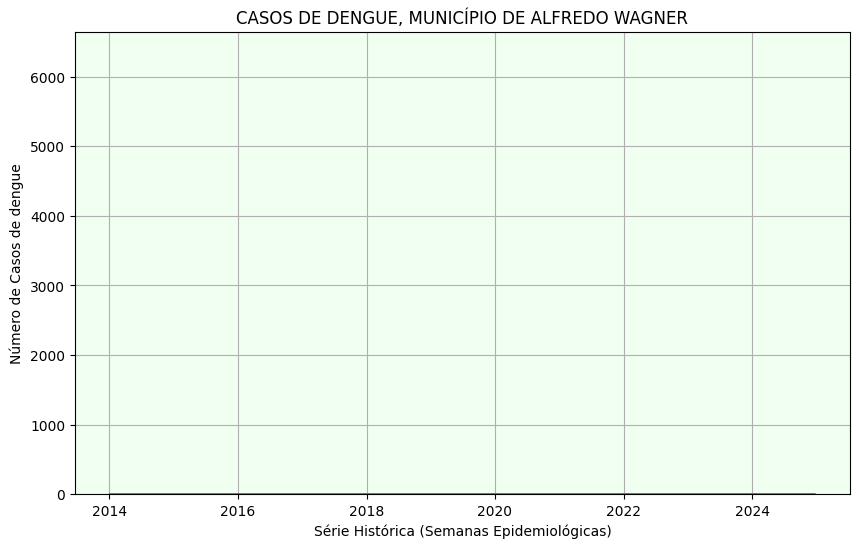

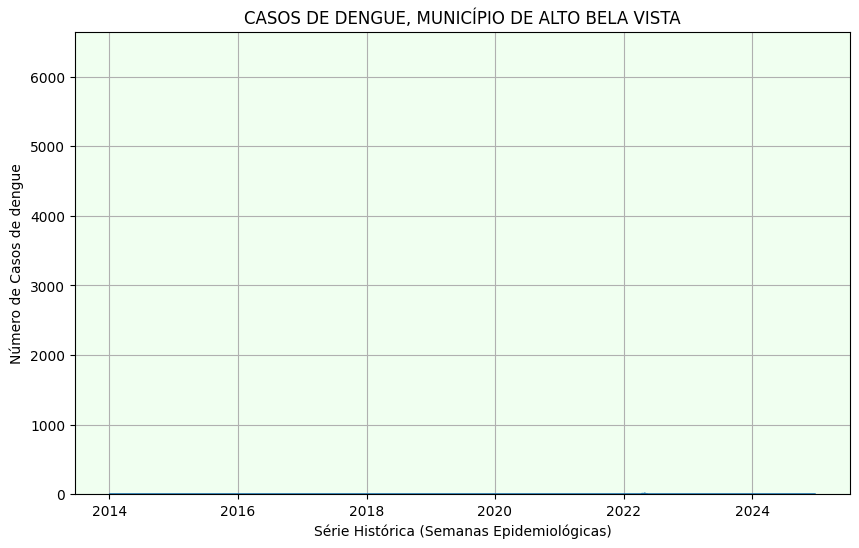

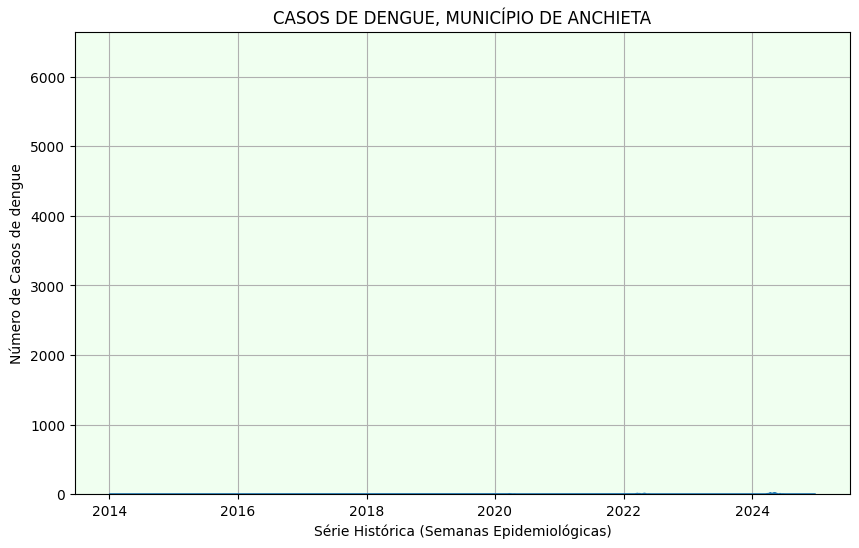

...

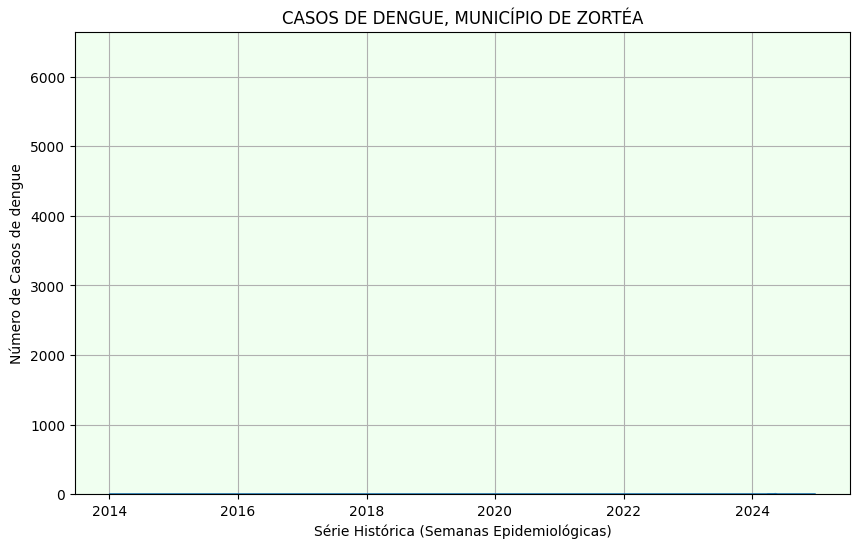

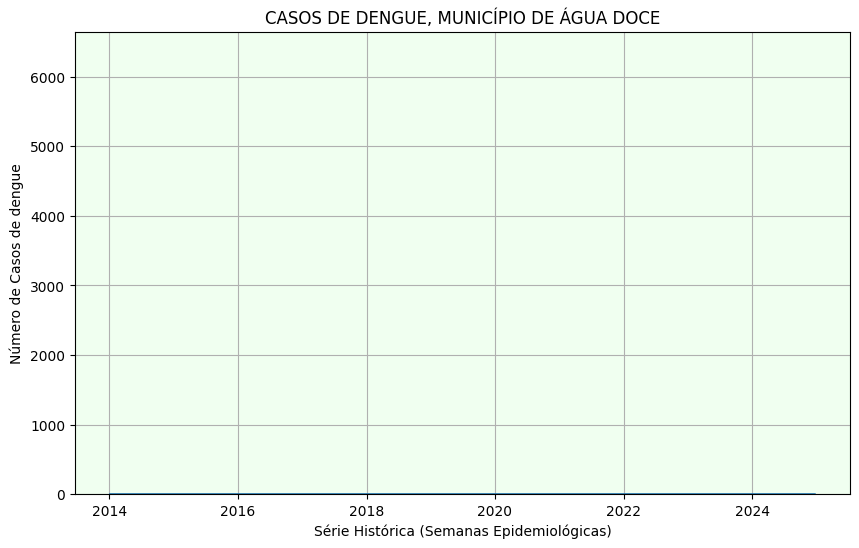

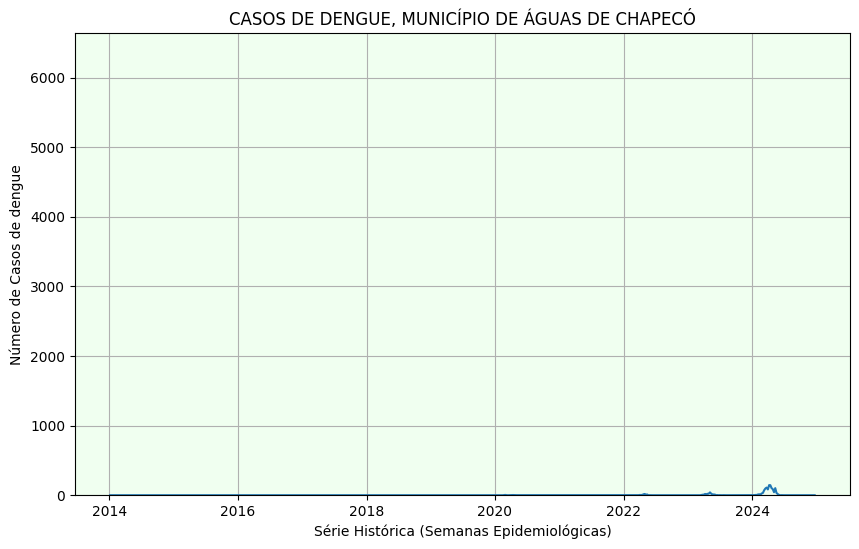

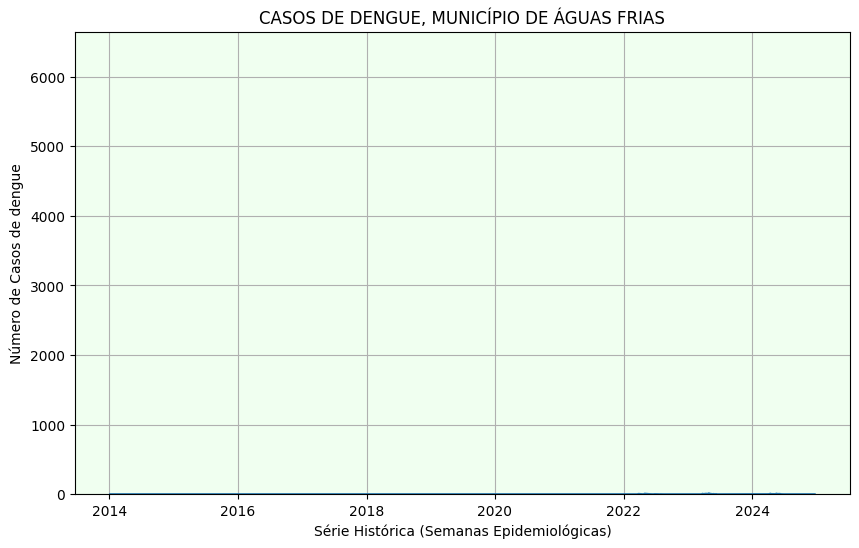

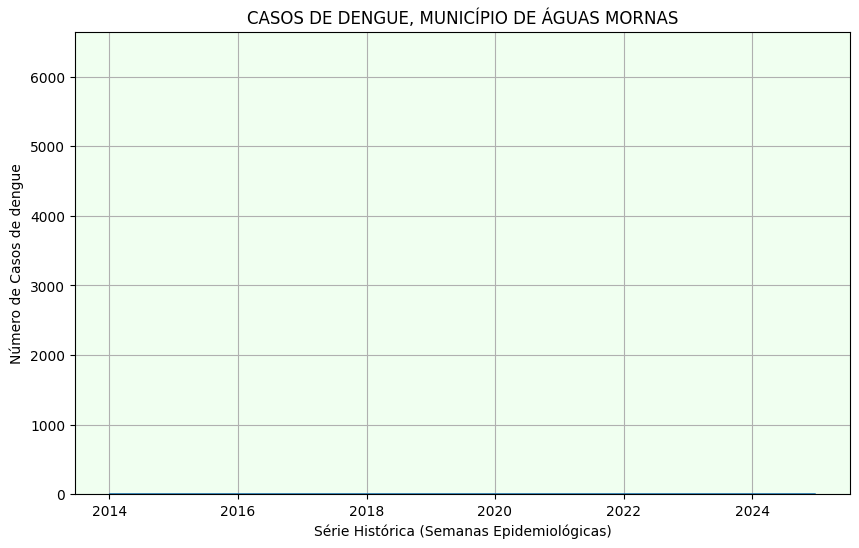

In [ ]:
sem_tempo = casos.drop(columns = "Semana")
for municipio in municipios:
  plt.figure(figsize=(10, 6))
  plt.plot(casos["Semana"], casos[municipio])
  plt.title(f"CASOS DE DENGUE, MUNICÍPIO DE {municipio}")
  plt.xlabel("Série Histórica (Semanas Epidemiológicas)")
  plt.ylabel("Número de Casos de dengue")
  plt.grid(True)
  plt.gca().set_ylim(0, sem_tempo.max().max())
  plt.gca().patch.set_facecolor("honeydew")
  plt.show()

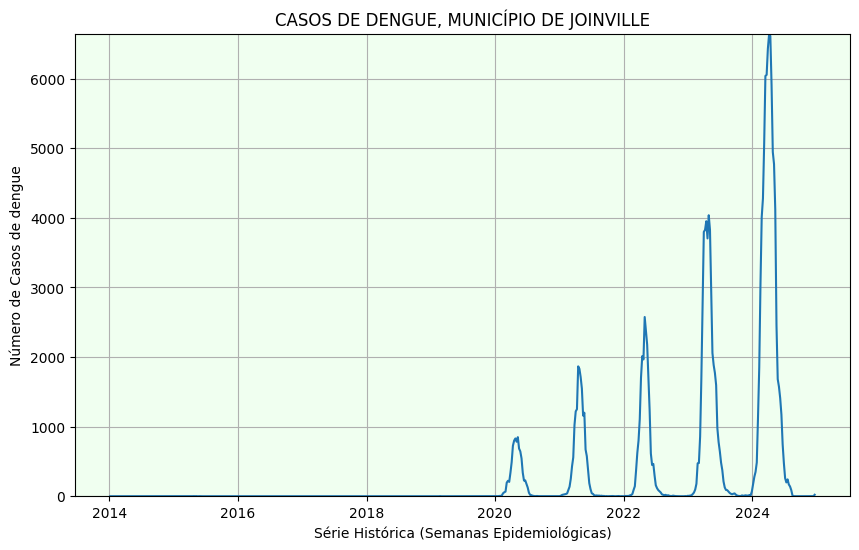

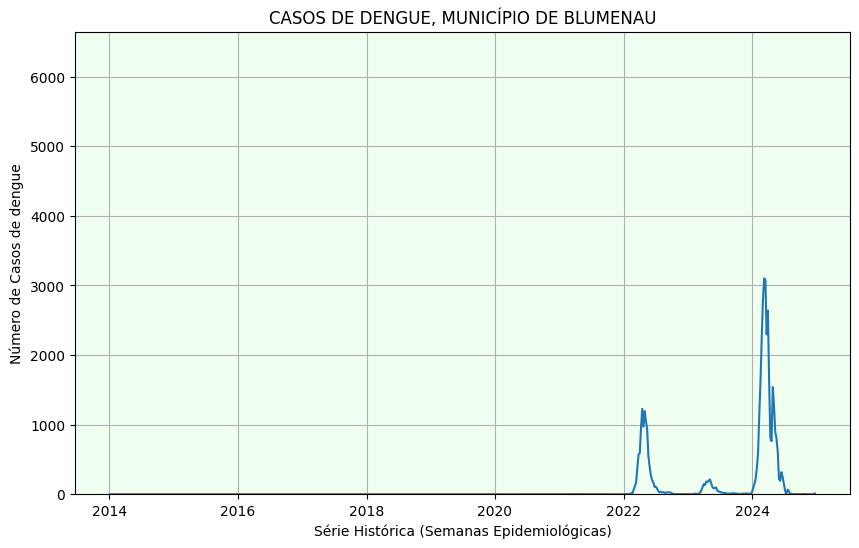

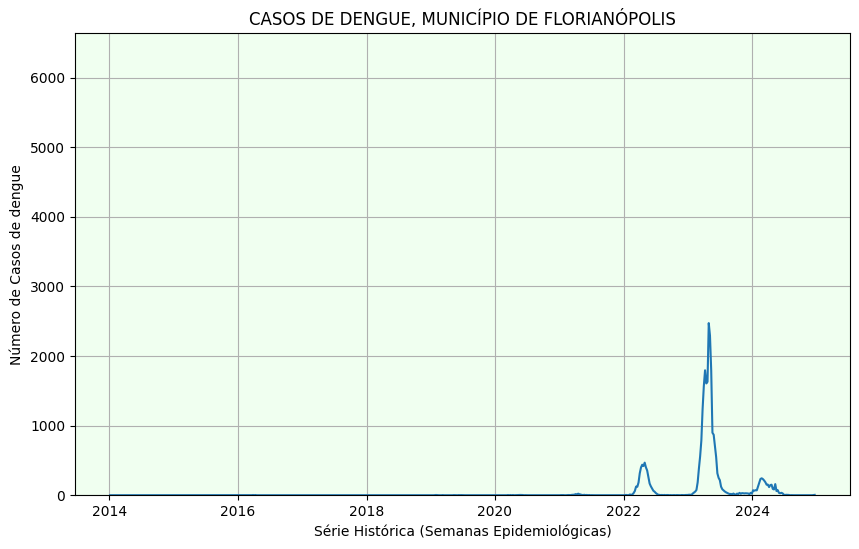

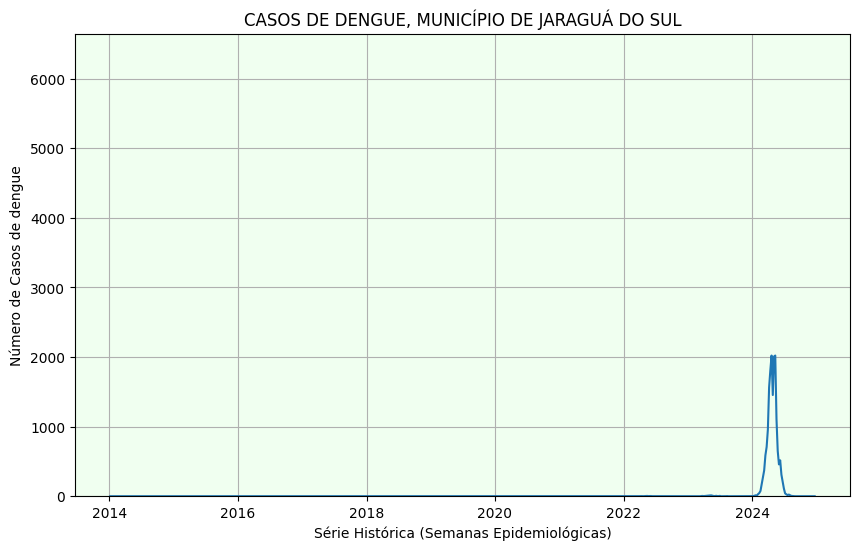

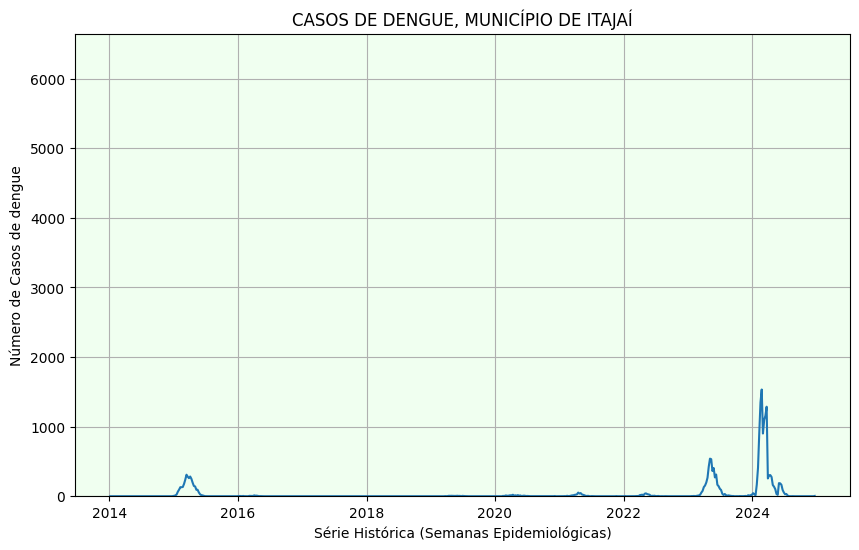

...

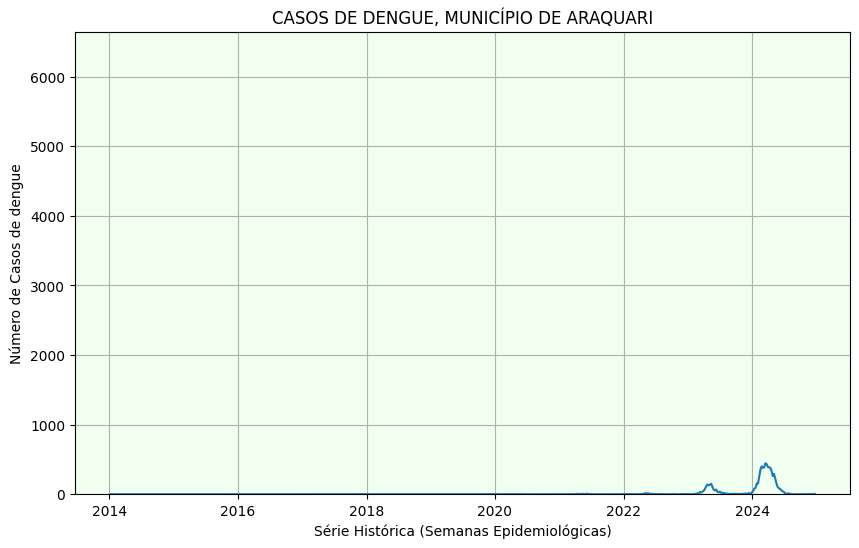

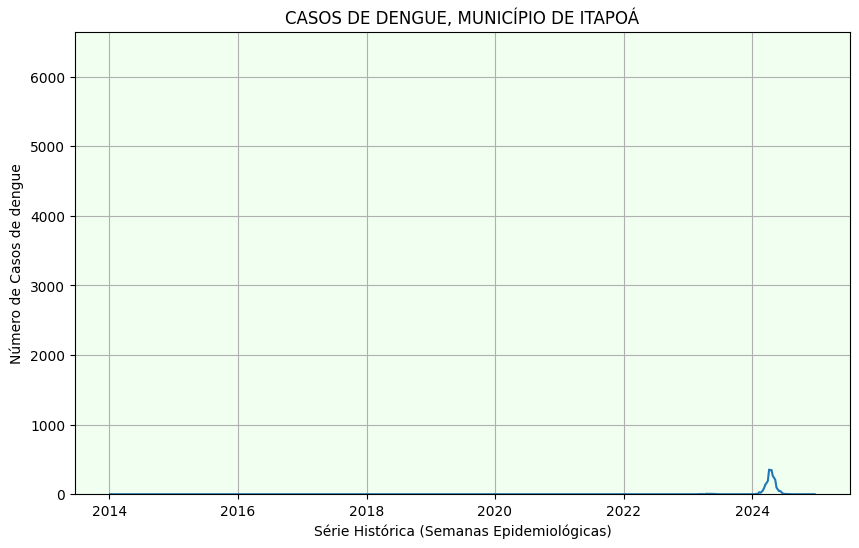

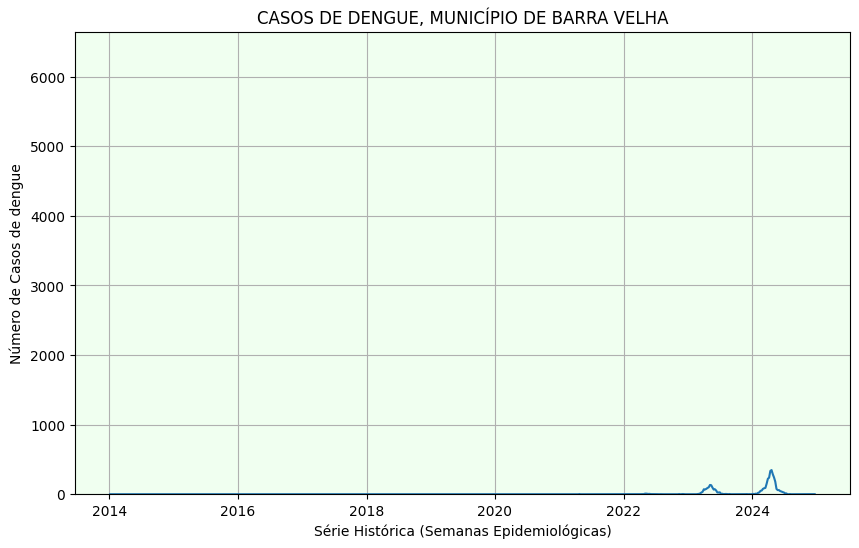

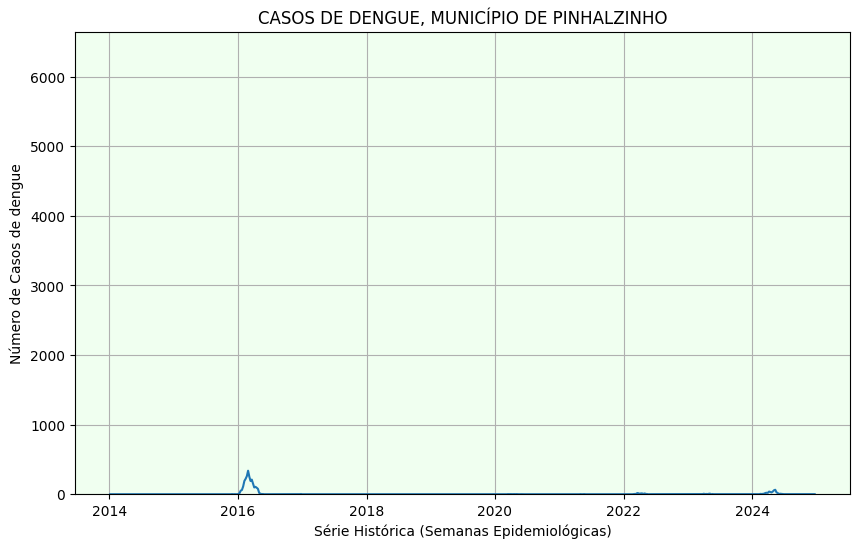

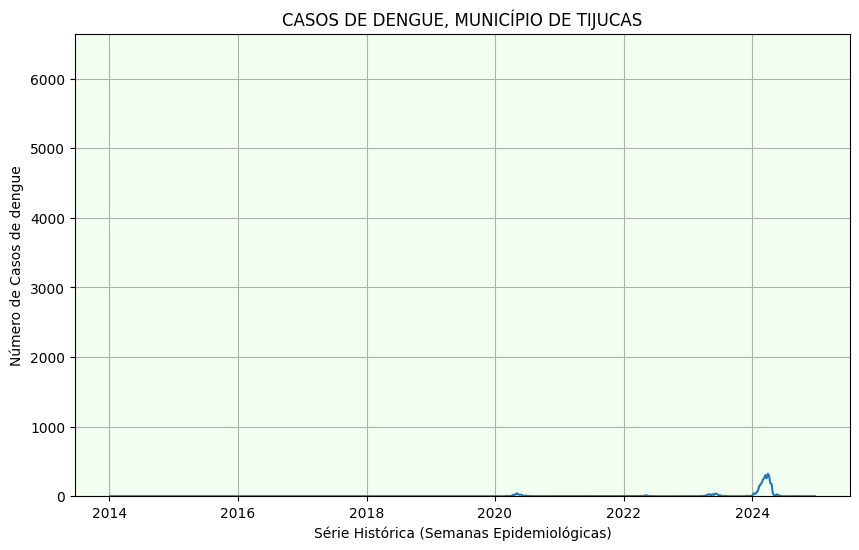

In [ ]:
sem_tempo = casos.drop(columns = "Semana")
for municipio in principais_max["Município"]:
  plt.figure(figsize=(10, 6))
  plt.plot(casos["Semana"], casos[municipio])
  plt.title(f"CASOS DE DENGUE, MUNICÍPIO DE {municipio}")
  plt.xlabel("Série Histórica (Semanas Epidemiológicas)")
  plt.ylabel("Número de Casos de dengue")
  plt.grid(True)
  plt.gca().set_ylim(0, sem_tempo.max().max())
  plt.gca().patch.set_facecolor("honeydew")
  plt.show()

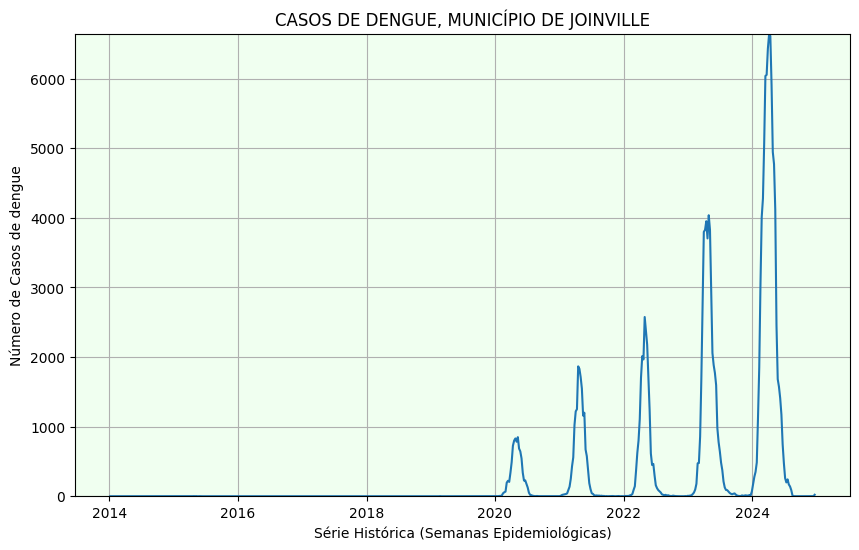

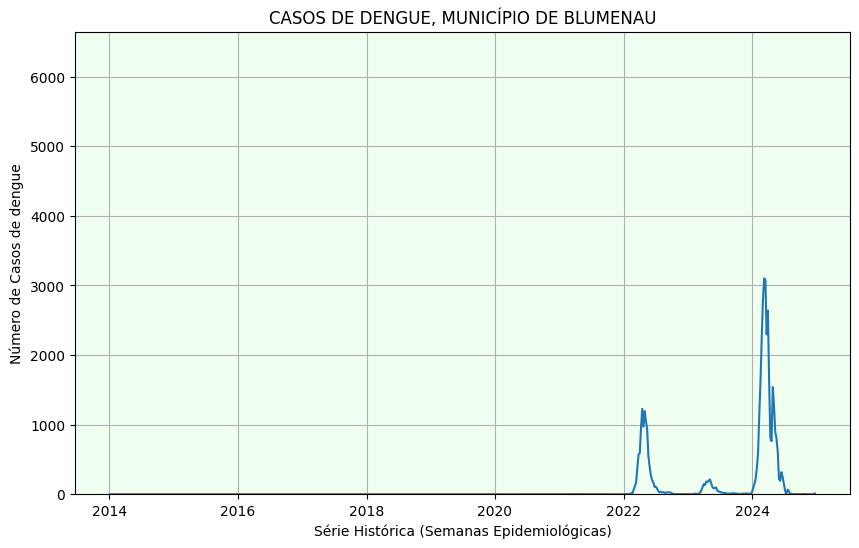

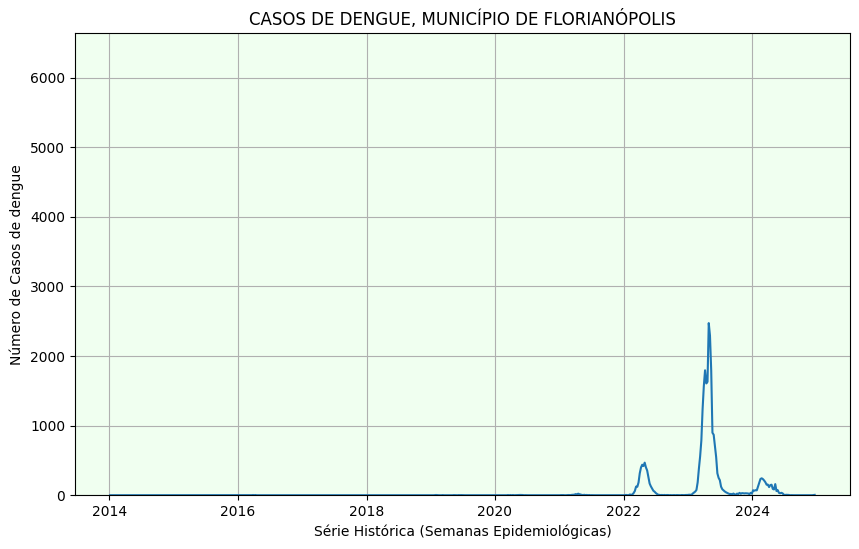

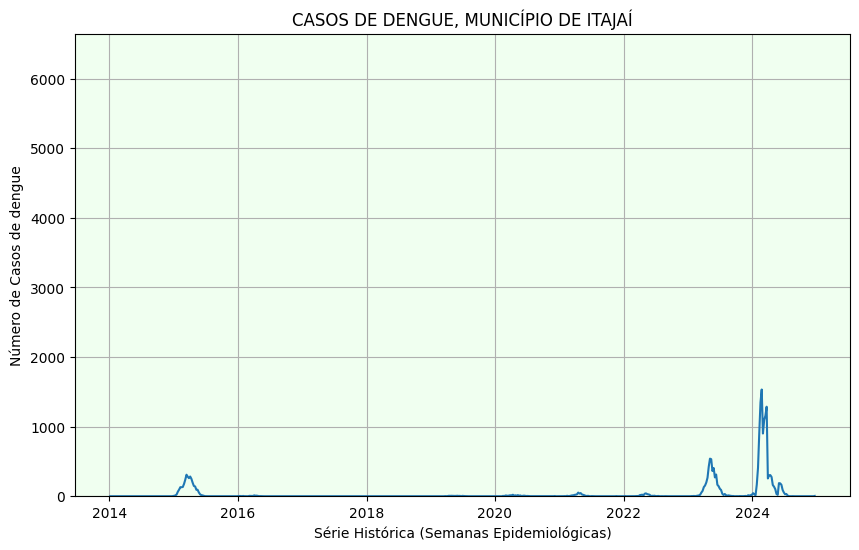

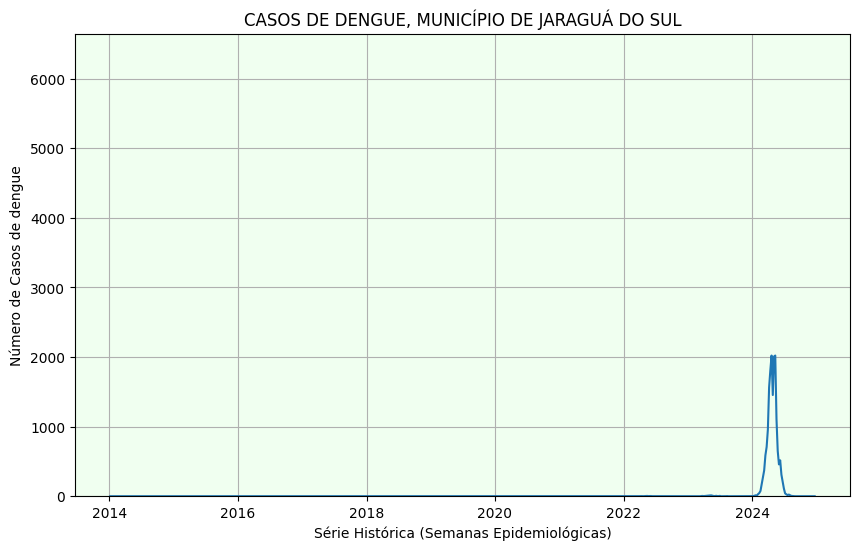

...

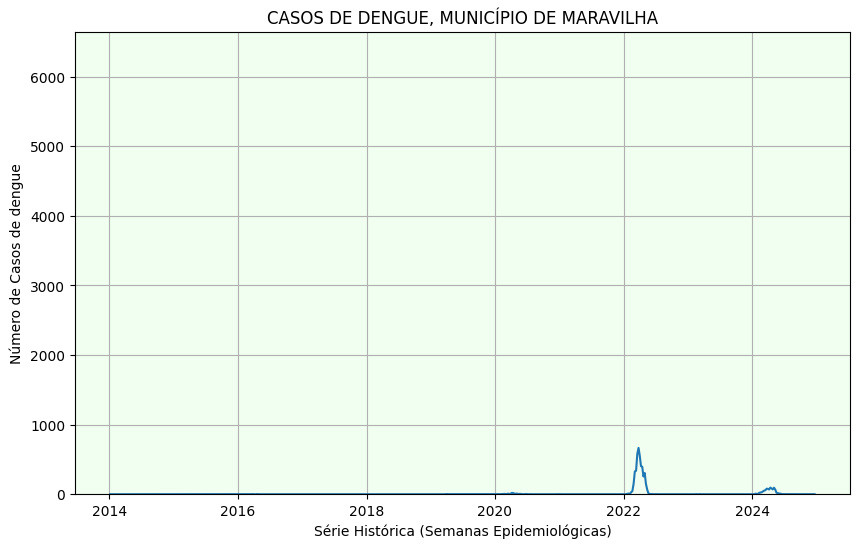

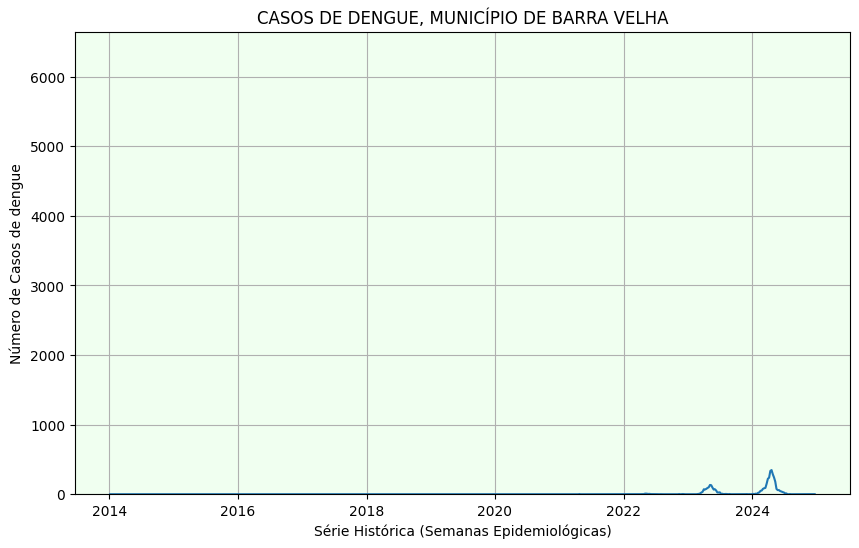

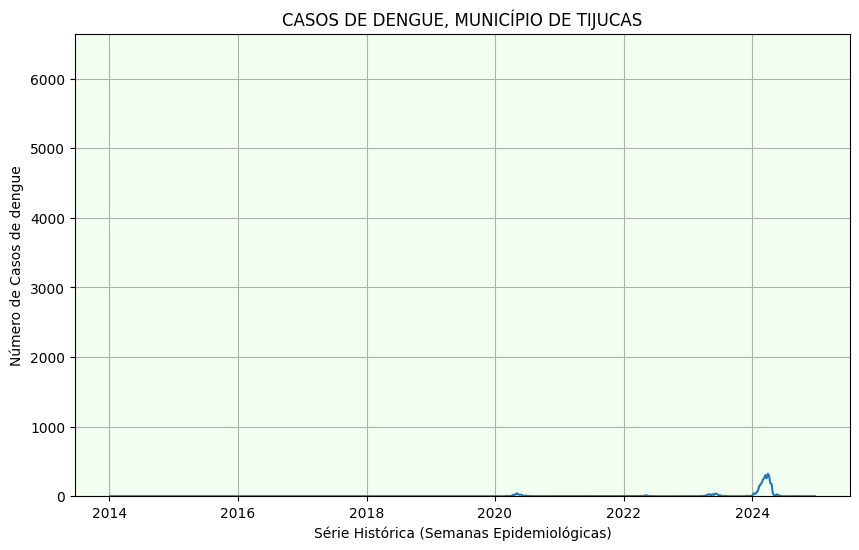

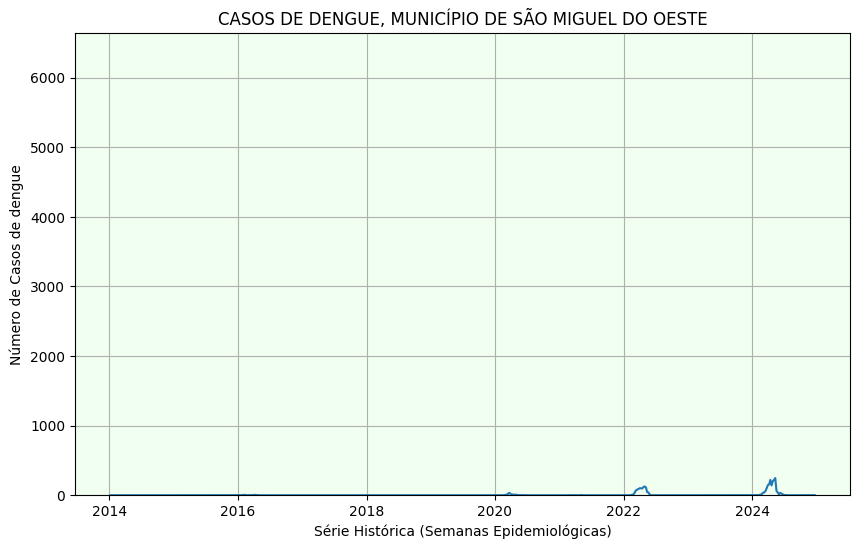

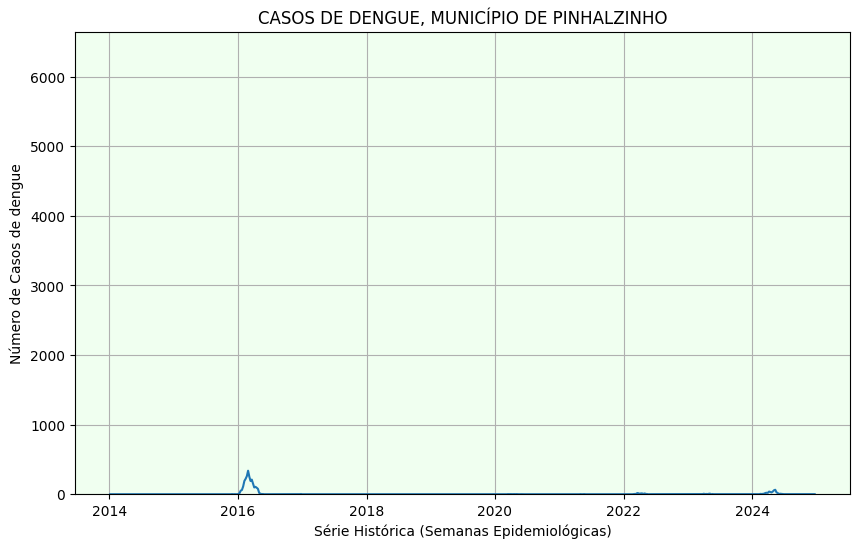

In [ ]:
sem_tempo = casos.drop(columns = "Semana")
for municipio in principais_soma["Município"]:
  plt.figure(figsize=(10, 6))
  plt.plot(casos["Semana"], casos[municipio])
  plt.title(f"CASOS DE DENGUE, MUNICÍPIO DE {municipio}")
  plt.xlabel("Série Histórica (Semanas Epidemiológicas)")
  plt.ylabel("Número de Casos de dengue")
  plt.grid(True)
  plt.gca().set_ylim(0, sem_tempo.max().max())
  plt.gca().patch.set_facecolor("honeydew")
  plt.show()